<a href="https://colab.research.google.com/github/LEOFRANKLIN2003/Gesture_Detection/blob/main/Gesture_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Import necessary libraries
import cv2
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow
import torch
import torchvision.transforms as transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn

# Upload files
uploaded = files.upload()


Saving test_video.mp4 to test_video (1).mp4


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


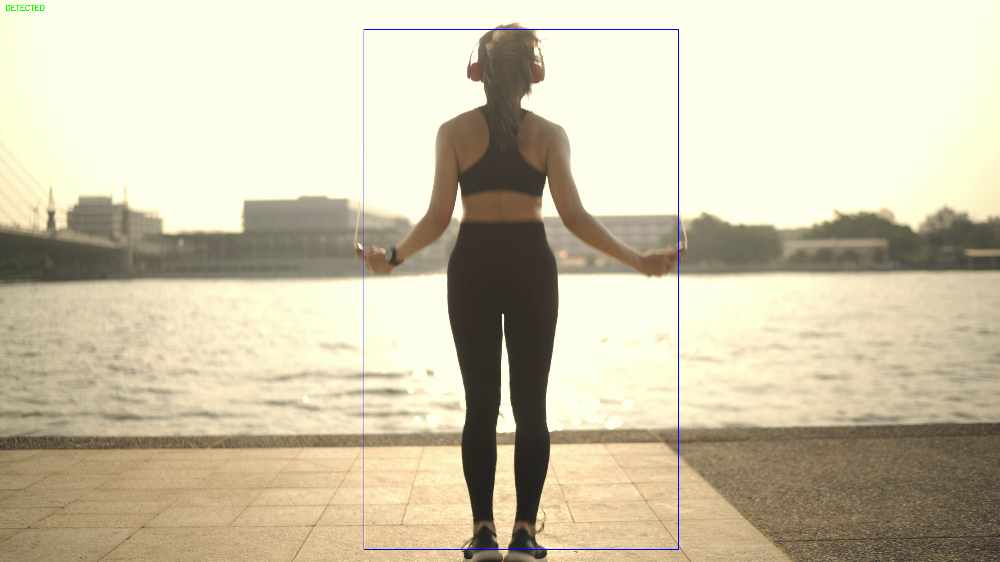

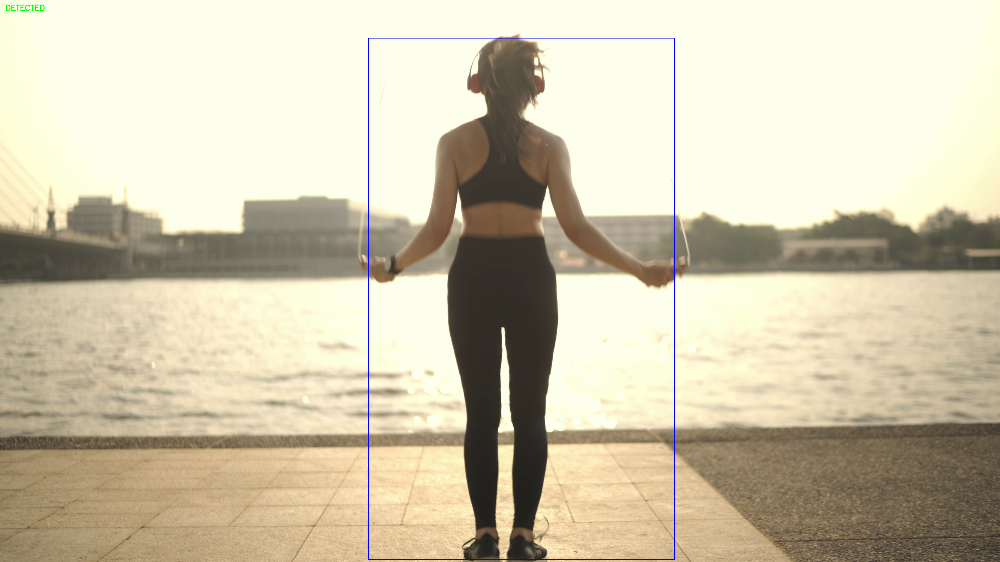

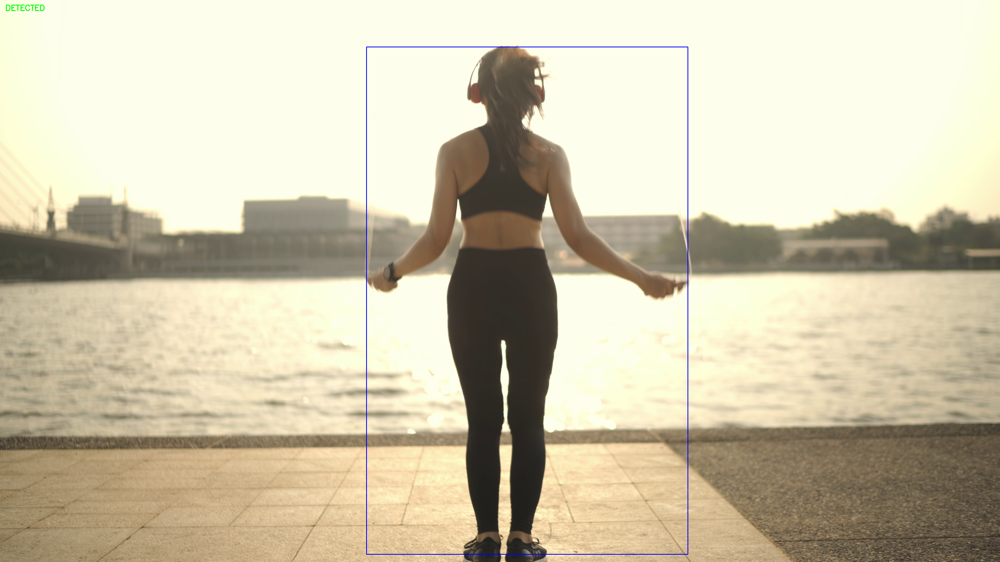

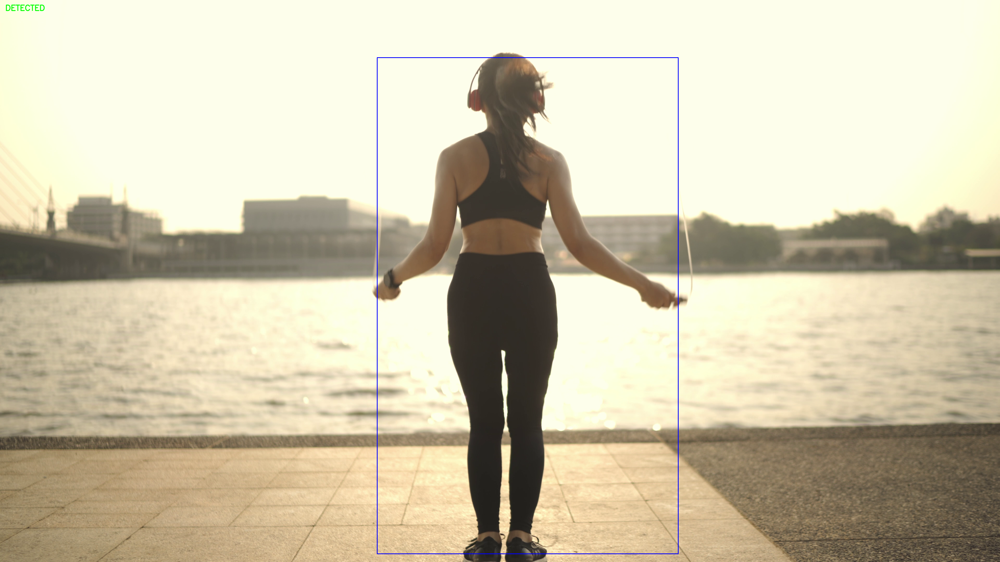

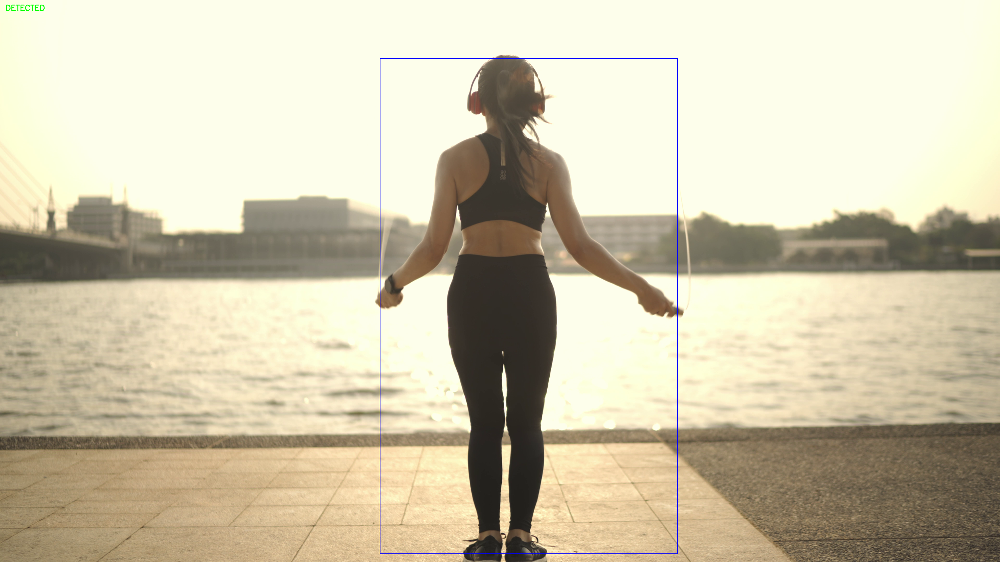

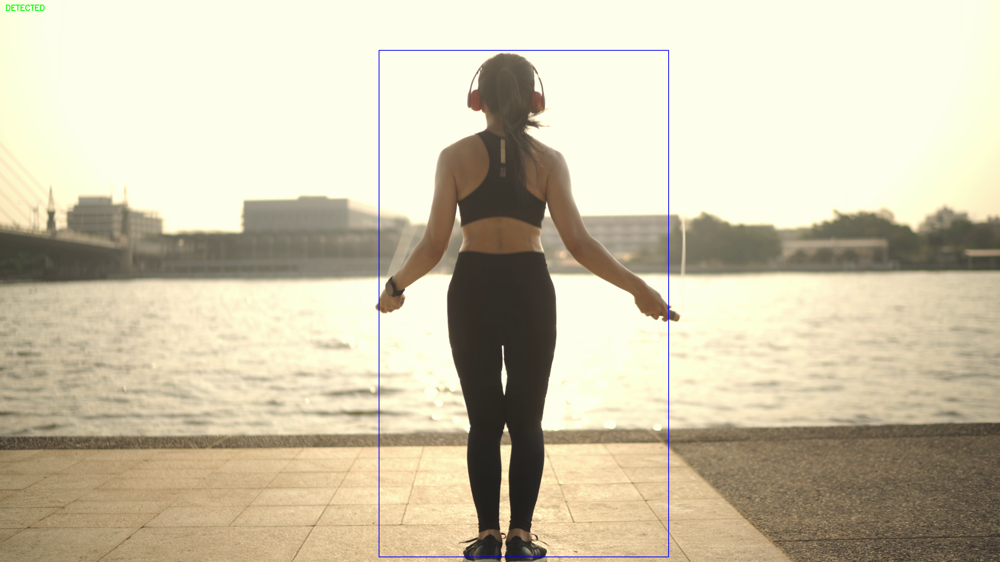

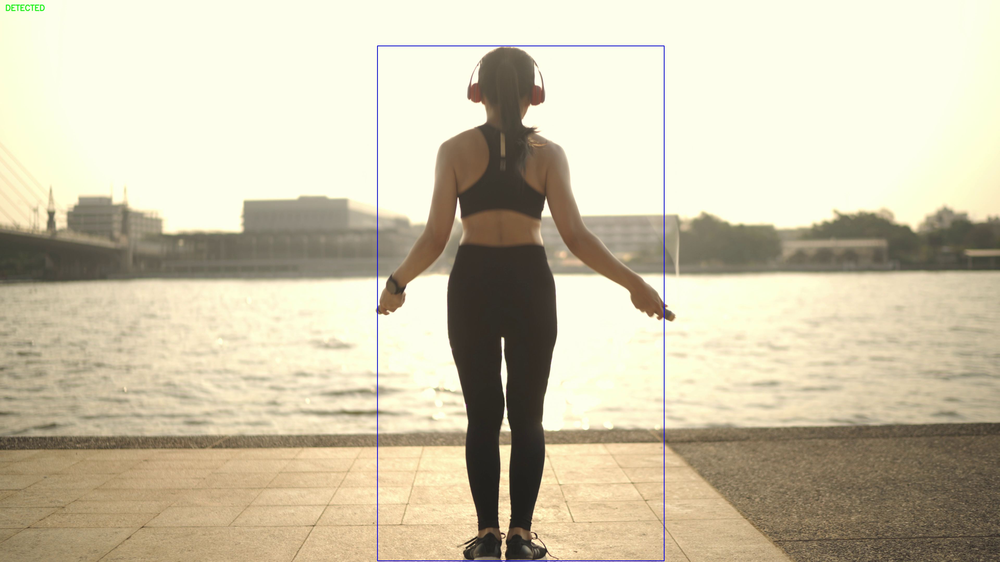

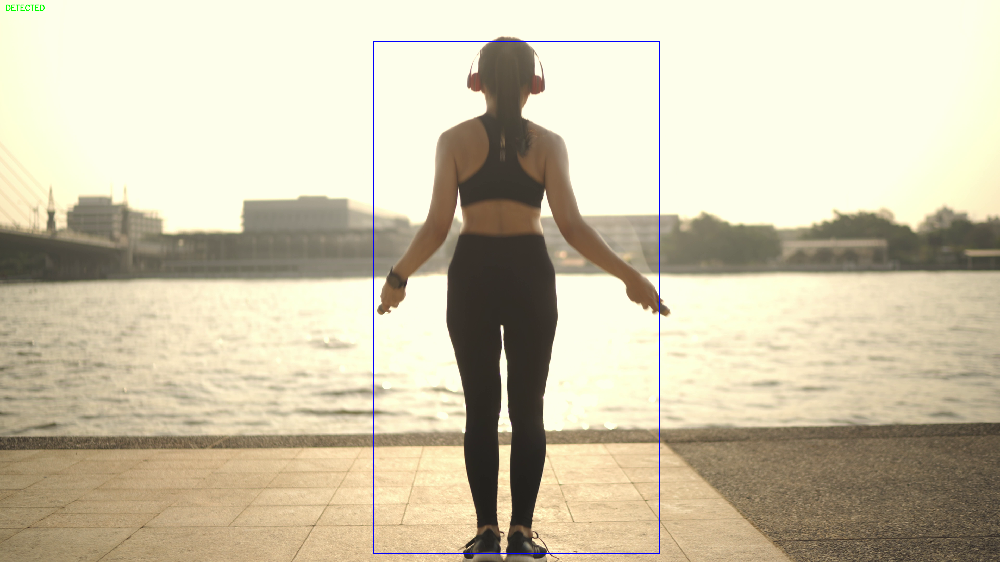

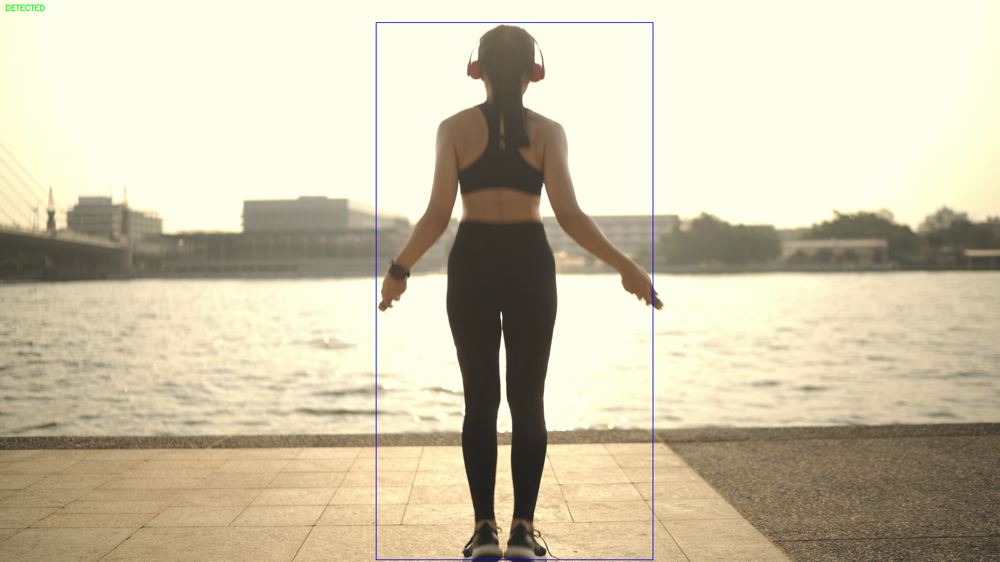

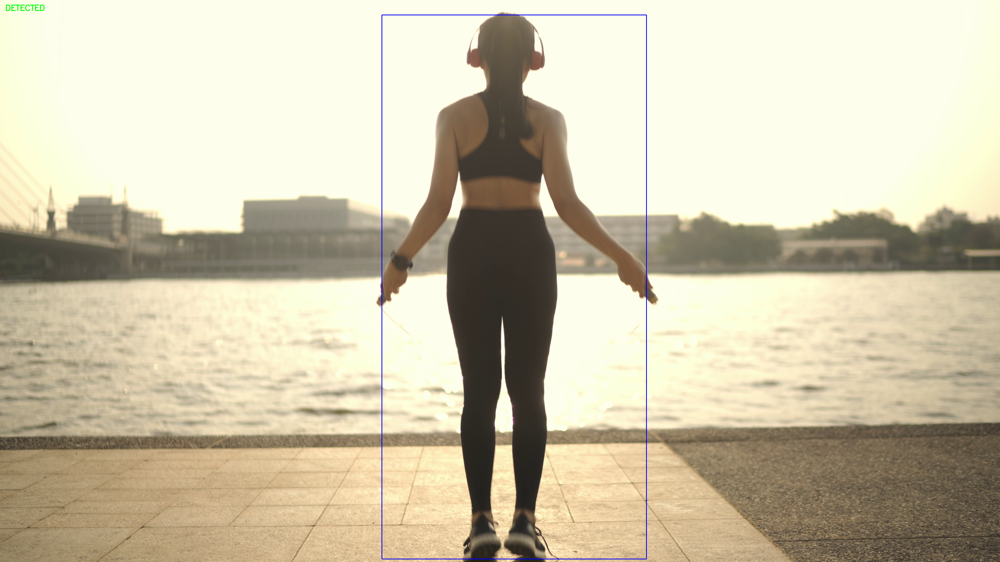

Buffered data was truncated after reaching the output size limit.

In [ ]:
# Load test video
test_video_path = next(iter(uploaded))
cap = cv2.VideoCapture(test_video_path)


frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)

# Define video writer object
output_video_path = 'output_video.mp4'
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'MP4V'), fps, (frame_width, frame_height))


# Load pre-trained Faster R-CNN model
model = fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Define threshold for detection confidence
threshold = 0.5

# Define annotation parameters
font = cv2.FONT_HERSHEY_SIMPLEX
position = (20, 40)
font_scale = 1
font_color = (0, 255, 0)  # Bright green color
thickness = 2

# Define transformation to apply to frames
transform = transforms.Compose([transforms.ToTensor()])

# Function to detect skipping gesture in a frame
def Gesture_Detection(frame):
    # Convert frame to tensor and unsqueeze to add batch dimension
    input_tensor = transform(frame).unsqueeze(0)

    # Forward pass through the model
    with torch.no_grad():
        predictions = model(input_tensor)

    # Extract bounding boxes and labels from predictions
    boxes = predictions[0]['boxes'].cpu().numpy()
    labels = predictions[0]['labels'].cpu().numpy()
    scores = predictions[0]['scores'].cpu().numpy()

    # Filter predictions based on threshold
    Gesture_boxes = boxes[scores >= threshold]

    return Gesture_boxes

# Iterate through video frames
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Detect skipping gesture in the frame
    skipping_boxes = Gesture_Detection(frame)

    # Annotate frames where skipping gesture is detected
    if len(skipping_boxes) > 0:
        cv2.putText(frame, 'DETECTED', position, font, font_scale, font_color, thickness, cv2.LINE_AA)

        # Draw bounding boxes around detected skipping gestures
        for box in skipping_boxes:
            x1, y1, x2, y2 = map(int, box)
            cv2.rectangle(frame, (x1, y1), (x2, y2), (255, 0, 0), thickness=2)

    out.write(frame)

    # Display the frame
    cv2_imshow(frame)

    # Check for 'q' key press to exit
    if cv2.waitKey(25) & 0xFF == ord('q'):
        break

cap.release()
out.release()
cv2.destroyAllWindows()

files.download(output_video_path)
